In [1]:
%%capture
!pip install ultralytics
!pip install roboflow

In [ ]:
from ultralytics import YOLO
import os
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo mode=checks

In [3]:
from getpass import getpass

ROBOFLOW_API_KEY = getpass('Enter the secret value: ')

from roboflow import Roboflow
rf = Roboflow(api_key=ROBOFLOW_API_KEY)
project = rf.workspace("mohamed-ahmed-cgrlk").project("car-models-yrkry")
dataset = project.version(2).download("yolov8")


Enter the secret value: ··········
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.0.227, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Car-Models-2 in yolov8:: 100%|██████████| 6988/6988 [00:01<00:00, 6597.57it/s]


In [5]:
!yolo task=detect mode=train model=yolov8m.pt data={dataset.location}/data.yaml epochs=25 imgsz=640

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/Car-Models-2/data.yaml, epochs=25, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=N

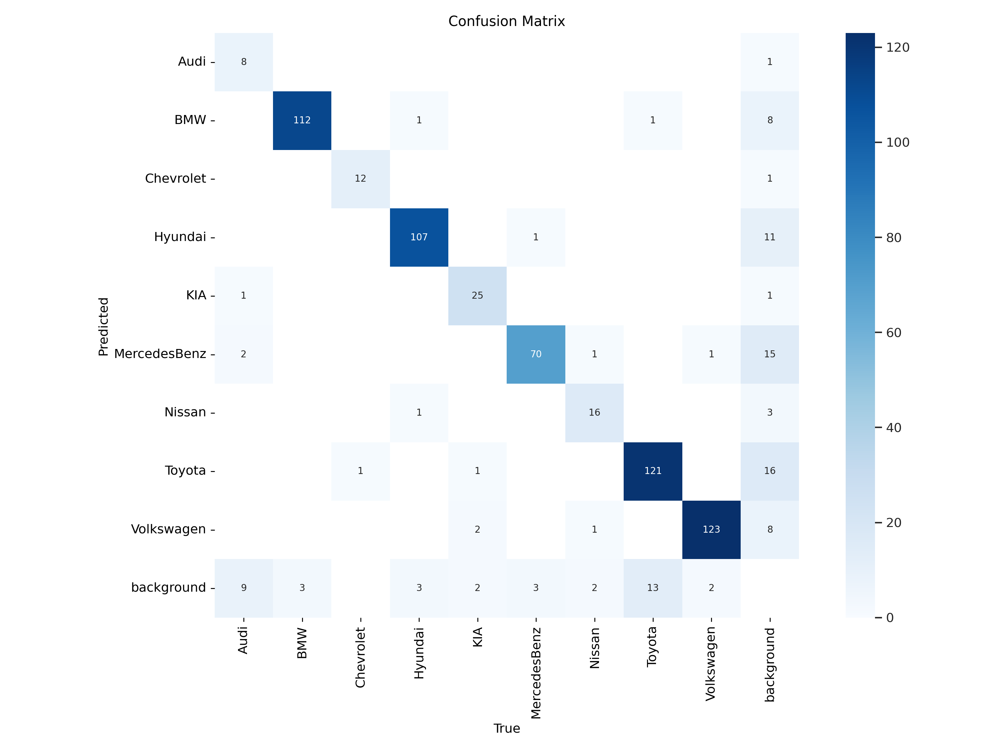

In [12]:
Image(filename=f'/content/runs/detect/train2/confusion_matrix.png', width=1000)

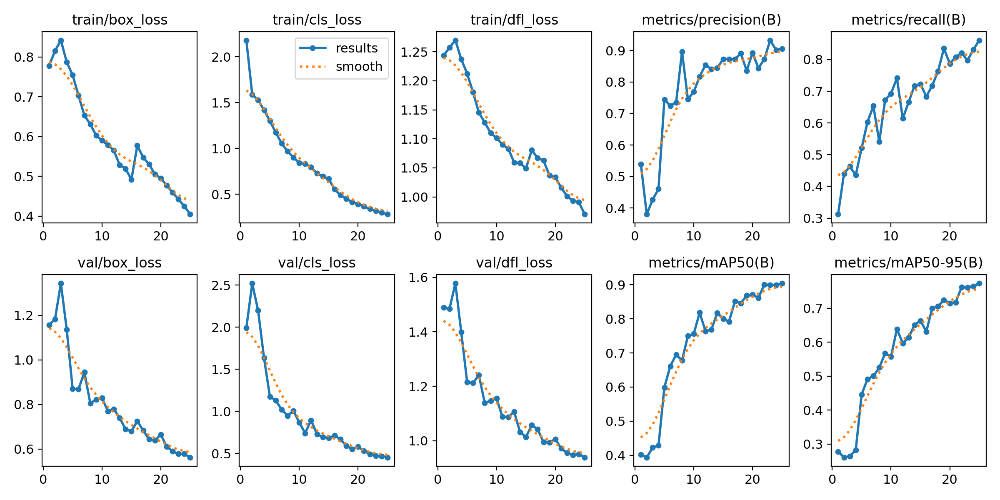

In [13]:
Image(filename = f'/content/runs/detect/train2/results.png', width=1000)

In [14]:
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25844971 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/Car-Models-2/valid/labels.cache... 599 images, 1 backgrounds, 0 corrupt: 100% 599/599 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 38/38 [00:08<00:00,  4.39it/s]
                   all        599        645       0.79      0.649      0.745      0.554
                  Audi        599         20      0.319        0.2      0.249      0.181
                   BMW        599        115      0.959      0.861      0.925      0.691
             Chevrolet        599         13          1      0.596      0.818      0.525
               Hyundai        599        112      0.847      0.714      0.816      0.467
                   KIA        599         30      0.729        0.4      0.576      0.477
          MercedesBenz        599

In [16]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.5 source={dataset.location}/test/images

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25844971 parameters, 0 gradients, 78.7 GFLOPs

image 1/257 /content/Car-Models-2/test/images/58_bmw_jpg.rf.e2d587613f27f2bd079eee024b40c0f1.jpg: 640x640 1 BMW, 9.4ms
image 2/257 /content/Car-Models-2/test/images/5_bmw_jpg.rf.39bd3731c7ca5d9734d6fd0e51d5325a.jpg: 640x640 (no detections), 9.4ms
image 3/257 /content/Car-Models-2/test/images/65_bmw_jpg.rf.bcd79e26d71e6b5663a1d0bea8b69d3c.jpg: 640x640 1 BMW, 9.6ms
image 4/257 /content/Car-Models-2/test/images/7200_jpg.rf.0da005ffda33e9239fda43d28865719b.jpg: 640x640 (no detections), 9.4ms
image 5/257 /content/Car-Models-2/test/images/75_bmw_jpg.rf.837af0c16bb25d2a4f3f33a04c313f7e.jpg: 640x640 (no detections), 9.3ms
image 6/257 /content/Car-Models-2/test/images/88_bmw_jpg.rf.d6b73e5430d8769445886b21b60d9ddf.jpg: 640x640 1 BMW, 9.3ms
image 7/257 /content/Car-Models-2/test/images/91_bmw_jpg.rf.14b21e2d83af537db

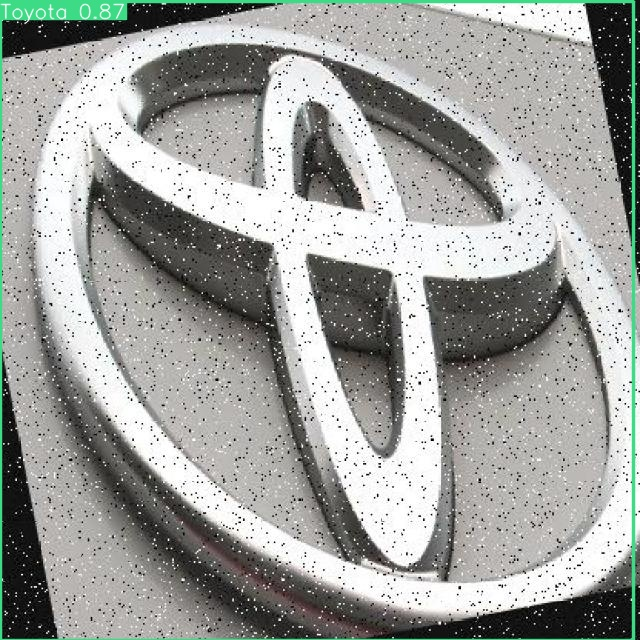

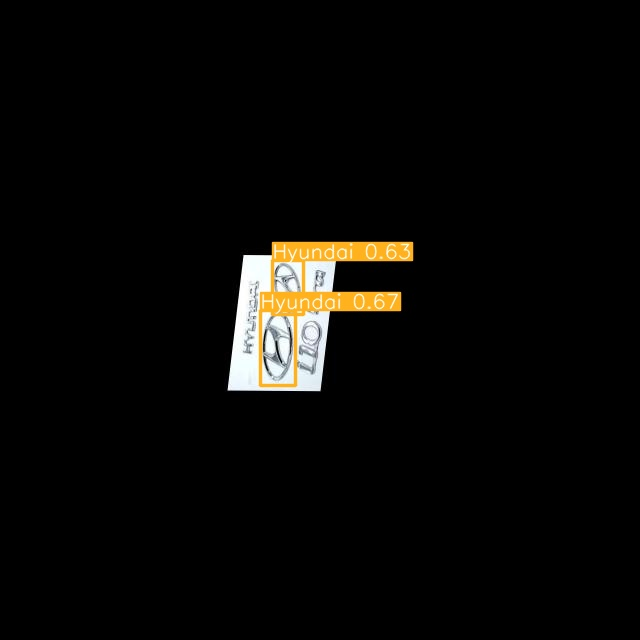

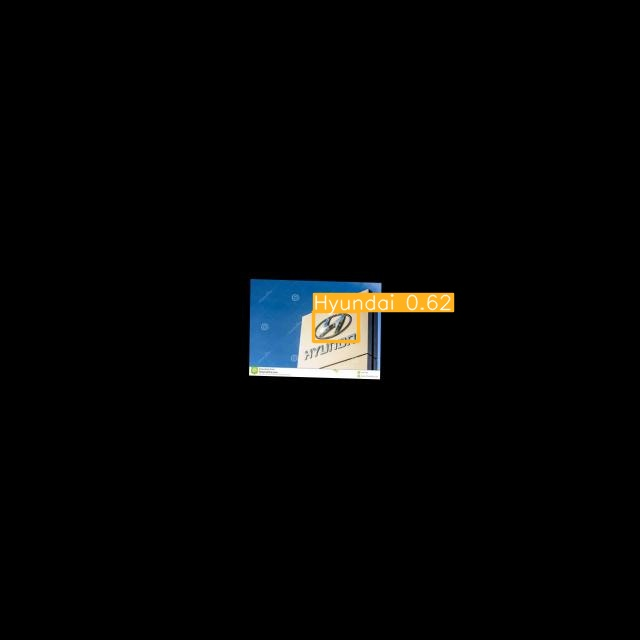

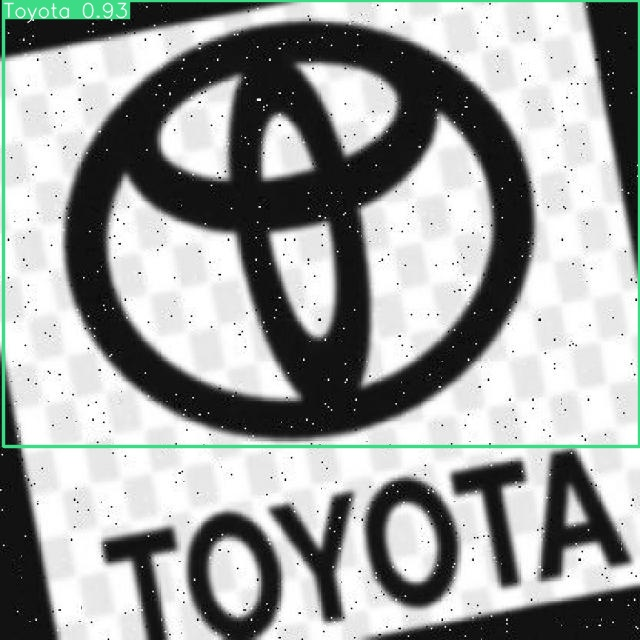

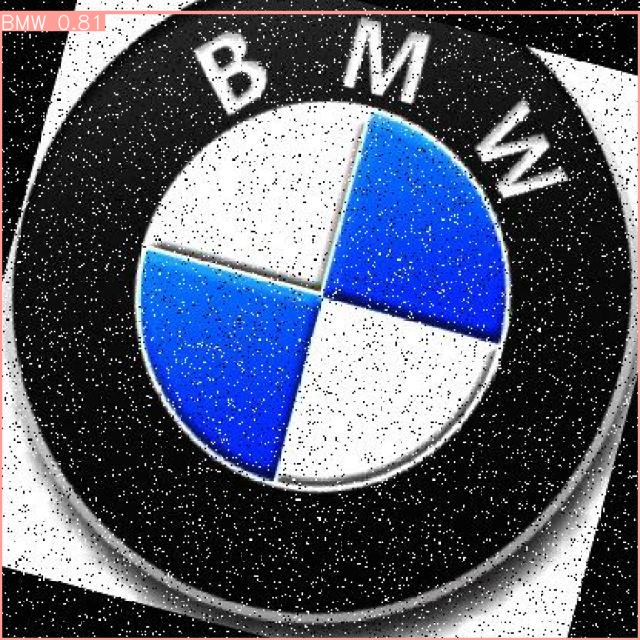

...

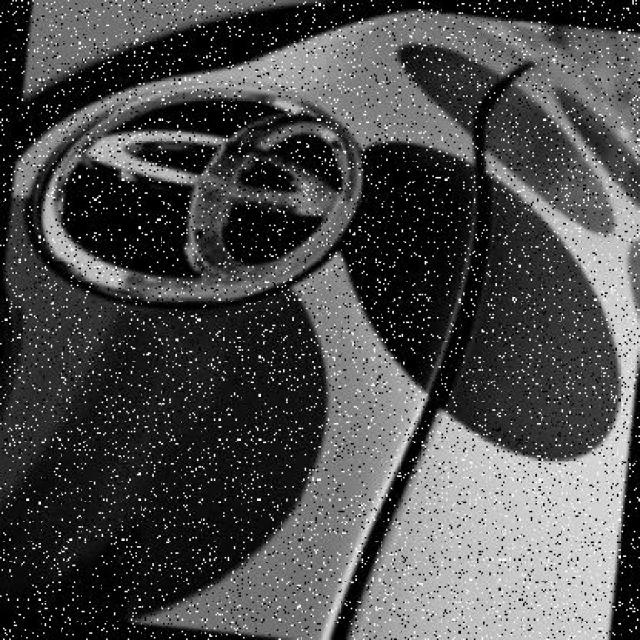

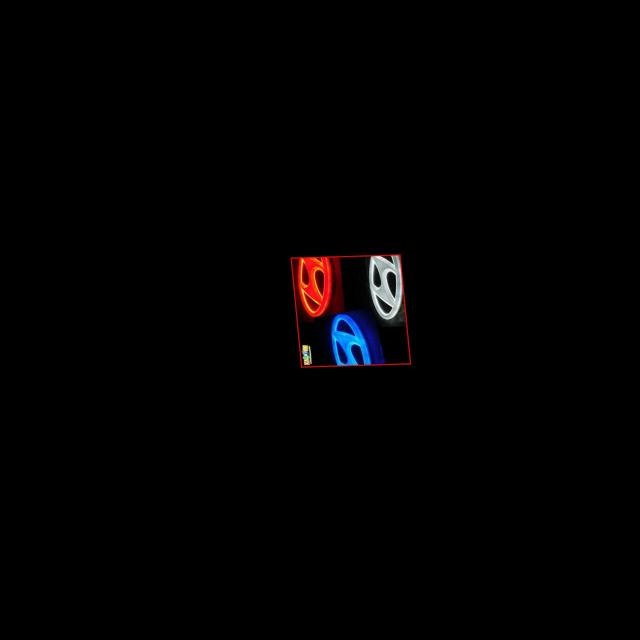

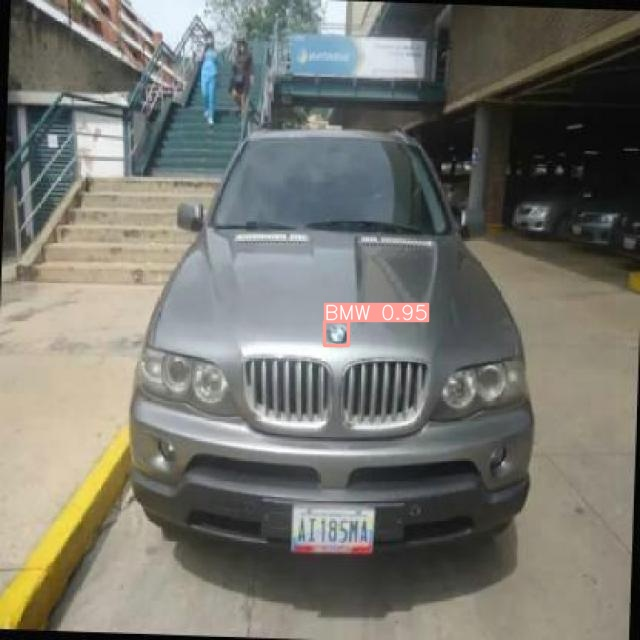

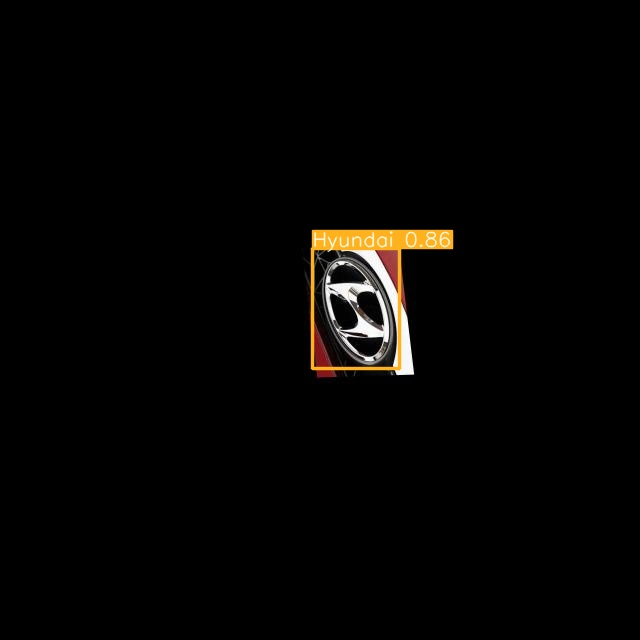

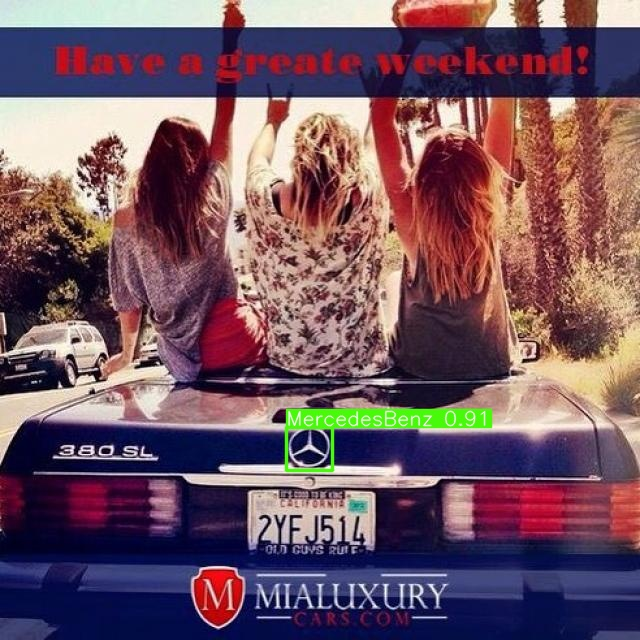

In [18]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg'):
  display(Image(filename=image_path, height=600))
  print('\n')